In [20]:
!pip install vallenae
!pip install PyWavelets

In [2]:
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import vallenae as vae
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
import pywt

TRADB = Path("C:/all/vallen/plate-dataset/sherbet-powder.tradb")
tradb=vae.io.TraDatabase(TRADB)
full_df = tradb.read()

Tra: 100%|██████████| 6929/6929 [00:00<00:00, 29634.55it/s]


In [3]:
full_df

,time,channel,param_id,pretrigger,threshold,samplerate,samples,data,status,raw
trai,,,,,,,,,,
3,0.000299,4,3,1496,0.0001,5000000,5536,"[-3.0445285e-06, -6.089057e-06, 0.0, -1.217811...",32768,False
11,0.124386,4,3,2048,0.0001,5000000,12640,"[6.089057e-06, 3.0445285e-06, 6.089057e-06, 9....",32768,False
16,0.219409,5,4,2048,0.0001,5000000,29712,"[6.089057e-06, 0.0, 6.089057e-06, 0.0, 6.08905...",32768,False
18,0.225464,5,4,2048,0.0001,5000000,18912,"[-1.5222642e-05, -2.13117e-05, -1.2178114e-05,...",32768,False
23,0.236734,4,3,2048,0.0001,5000000,4272,"[-9.133586e-06, -9.133586e-06, -1.2178114e-05,...",32768,False
...,...,...,...,...,...,...,...,...,...,...
31196,955.551274,3,2,2048,0.0001,5000000,11136,"[-6.089057e-06, -3.0445285e-06, 0.0, -3.044528...",32768,False
31197,955.551333,6,5,2048,0.0001,5000000,5200,"[-3.0445285e-06, 0.0, 0.0, 3.0445285e-06, -3.0...",32768,False
31198,955.562174,4,3,2048,0.0001,5000000,13808,"[-6.089057e-06, -6.089057e-06, -1.2178114e-05,...",32768,False


In [4]:
df1=pd.DataFrame()

In [5]:
df1['data']=full_df['data']

In [6]:
df1['label']=0

In [7]:
df1

,data,label
trai,,
3,"[-3.0445285e-06, -6.089057e-06, 0.0, -1.217811...",0
11,"[6.089057e-06, 3.0445285e-06, 6.089057e-06, 9....",0
16,"[6.089057e-06, 0.0, 6.089057e-06, 0.0, 6.08905...",0
18,"[-1.5222642e-05, -2.13117e-05, -1.2178114e-05,...",0
23,"[-9.133586e-06, -9.133586e-06, -1.2178114e-05,...",0
...,...,...
31196,"[-6.089057e-06, -3.0445285e-06, 0.0, -3.044528...",0
31197,"[-3.0445285e-06, 0.0, 0.0, 3.0445285e-06, -3.0...",0
31198,"[-6.089057e-06, -6.089057e-06, -1.2178114e-05,...",0


In [8]:


TRADB = Path("C:/all/vallen/plate-dataset/fiber-friction.tradb")
tradb=vae.io.TraDatabase(TRADB)
full_df = tradb.read()
df2=pd.DataFrame()
df2['data']=full_df['data']
df2['label']=1
df2

Tra: 100%|██████████| 7011/7011 [00:00<00:00, 34949.50it/s]


,data,label
trai,,
3,"[3.0445285e-06, 3.0445285e-06, -2.13117e-05, -...",1
4,"[6.089057e-06, 0.0, 3.0445285e-06, 0.0, -9.133...",1
7,"[3.0445285e-06, 6.089057e-06, 0.0, 0.0, -1.217...",1
8,"[-3.0445285e-06, 6.089057e-06, 0.0, 3.0445285e...",1
11,"[6.089057e-06, 2.13117e-05, 3.0445284e-05, 3.6...",1
...,...,...
24118,"[-3.0445285e-06, -9.133586e-06, -1.2178114e-05...",1
24119,"[9.133586e-06, 6.089057e-06, 3.0445285e-06, -3...",1
24121,"[-9.133586e-06, -9.133586e-06, -9.133586e-06, ...",1


In [9]:
TRADB = Path("C:/all/vallen/plate-dataset/sand.tradb")
tradb=vae.io.TraDatabase(TRADB)
full_df = tradb.read()
df3=pd.DataFrame()
df3['data']=full_df['data']
df3['label']=2
df3

Tra: 100%|██████████| 6929/6929 [00:00<00:00, 19709.12it/s]


,data,label
trai,,
5,"[-3.0445285e-06, 0.0, -3.0445285e-06, -9.13358...",2
8,"[-2.7400756e-05, -2.4356228e-05, -2.13117e-05,...",2
13,"[1.2178114e-05, 1.2178114e-05, 1.2178114e-05, ...",2
16,"[4.26234e-05, 3.3489814e-05, 3.0445284e-05, 2....",2
21,"[-1.5222642e-05, -1.5222642e-05, 0.0, -3.04452...",2
...,...,...
40384,"[0.0, -3.0445285e-06, -3.0445285e-06, 3.044528...",2
40388,"[0.0, 1.2178114e-05, 0.0, 3.0445285e-06, 3.044...",2
40399,"[1.2178114e-05, 0.0, 3.0445285e-06, 3.0445285e...",2


In [10]:
TRADB = Path("C:/all/vallen/plate-dataset/sand-friction.tradb")
tradb=vae.io.TraDatabase(TRADB)
full_df = tradb.read()
df4=pd.DataFrame()
df4['data']=full_df['data']
df4['label']=3
df4

Tra: 100%|██████████| 6988/6988 [00:00<00:00, 37939.96it/s]


,data,label
trai,,
1,"[9.133586e-06, 3.0445285e-06, 9.133586e-06, 1....",3
2,"[0.0, 0.0, -1.5222642e-05, -1.2178114e-05, -3....",3
3,"[6.089057e-06, 0.0, -9.133586e-06, -3.0445285e...",3
10,"[-6.089057e-06, -1.5222642e-05, -9.133586e-06,...",3
11,"[-3.0445285e-06, 0.0, 0.0, 6.089057e-06, 0.0, ...",3
...,...,...
13578,"[-3.0445285e-06, 3.0445285e-06, 6.089057e-06, ...",3
13581,"[-3.0445285e-06, -3.0445285e-06, 3.0445285e-06...",3
13582,"[-1.2178114e-05, -6.089057e-06, 3.0445285e-06,...",3


In [11]:
result = pd.concat([df1, df2,df3,df4], ignore_index=True)

In [12]:
result

,data,label
0,"[-3.0445285e-06, -6.089057e-06, 0.0, -1.217811...",0
1,"[6.089057e-06, 3.0445285e-06, 6.089057e-06, 9....",0
2,"[6.089057e-06, 0.0, 6.089057e-06, 0.0, 6.08905...",0
3,"[-1.5222642e-05, -2.13117e-05, -1.2178114e-05,...",0
4,"[-9.133586e-06, -9.133586e-06, -1.2178114e-05,...",0
...,...,...
27852,"[-3.0445285e-06, 3.0445285e-06, 6.089057e-06, ...",3
27853,"[-3.0445285e-06, -3.0445285e-06, 3.0445285e-06...",3
27854,"[-1.2178114e-05, -6.089057e-06, 3.0445285e-06,...",3
27855,"[3.0445285e-06, -6.089057e-06, -6.089057e-06, ...",3


In [13]:
a=result.drop(columns=['label'])

In [14]:
c=a["data"].tolist()
c

[array([-3.0445285e-06, -6.0890570e-06,  0.0000000e+00, ...,
         6.0890570e-06, -3.0445285e-06, -3.0445285e-06], dtype=float32),
 array([6.0890570e-06, 3.0445285e-06, 6.0890570e-06, ..., 1.2178114e-05,
        9.1335860e-06, 1.2178114e-05], dtype=float32),
 array([6.0890570e-06, 0.0000000e+00, 6.0890570e-06, ..., 1.5222642e-05,
        9.1335860e-06, 3.0445285e-06], dtype=float32),
 array([-1.5222642e-05, -2.1311700e-05, -1.2178114e-05, ...,
         2.7400756e-05,  3.0445284e-05,  4.5667926e-05], dtype=float32),
 array([-9.1335860e-06, -9.1335860e-06, -1.2178114e-05, ...,
        -2.7400756e-05, -9.1335860e-06, -2.1311700e-05], dtype=float32),
 array([ 6.0890570e-06, -3.0445285e-06,  0.0000000e+00, ...,
         3.3489814e-05,  2.7400756e-05,  1.8267172e-05], dtype=float32),
 array([-9.1335860e-06,  1.5222642e-05,  6.0890570e-06, ...,
         3.0445285e-06, -3.0445285e-06, -1.2178114e-05], dtype=float32),
 array([-3.0445285e-06,  6.0890570e-06,  0.0000000e+00, ...,
        -1.52

In [15]:
k=[]
for i in range(len(c)) : 
   
    l=c[i].tolist()
    k.append(l)

In [16]:
k

[[-3.0445285119640175e-06,
  -6.089057023928035e-06,
  0.0,
  -1.217811404785607e-05,
  -1.5222642105072737e-05,
  -6.089057023928035e-06,
  3.0445285119640175e-06,
  -3.0445285119640175e-06,
  -6.089057023928035e-06,
  6.089057023928035e-06,
  -3.0445285119640175e-06,
  0.0,
  -6.089057023928035e-06,
  3.0445285119640175e-06,
  6.089057023928035e-06,
  1.217811404785607e-05,
  3.0445285119640175e-06,
  0.0,
  -6.089057023928035e-06,
  0.0,
  6.089057023928035e-06,
  -3.0445285119640175e-06,
  -3.0445285119640175e-06,
  -3.0445285119640175e-06,
  -9.133585990639403e-06,
  -6.089057023928035e-06,
  -3.0445285119640175e-06,
  0.0,
  -1.217811404785607e-05,
  3.0445285119640175e-06,
  -9.133585990639403e-06,
  -1.217811404785607e-05,
  -1.217811404785607e-05,
  -9.133585990639403e-06,
  -6.089057023928035e-06,
  -9.133585990639403e-06,
  -6.089057023928035e-06,
  -9.133585990639403e-06,
  -1.5222642105072737e-05,
  -1.217811404785607e-05,
  -1.217811404785607e-05,
  -6.089057023928035e-06

In [17]:
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [18]:

d= pad_sequences(k, padding='post',value=0,dtype='float32',maxlen=5000)
d




array([[ 6.0890570e-06, -9.1335860e-06, -3.0445285e-06, ...,
         6.0890570e-06, -3.0445285e-06, -3.0445285e-06],
       [ 7.0024158e-05,  7.0024158e-05,  6.3935098e-05, ...,
         1.2178114e-05,  9.1335860e-06,  1.2178114e-05],
       [ 5.7846042e-05,  6.3935098e-05,  7.3068688e-05, ...,
         1.5222642e-05,  9.1335860e-06,  3.0445285e-06],
       ...,
       [-1.0351397e-04, -9.7424912e-05, -9.1335853e-05, ...,
         1.5222642e-05,  6.0890570e-06,  1.2178114e-05],
       [-6.0890570e-06,  6.0890570e-06,  3.0445285e-06, ...,
        -5.1756986e-05, -2.7400756e-05, -1.2178114e-05],
       [-9.1335853e-05, -7.9157740e-05, -5.7846042e-05, ...,
         1.8267172e-05,  6.0890570e-06,  1.2178114e-05]], dtype=float32)

In [19]:
y=np.array(result['label'].values)
y

array([0, 0, 0, ..., 3, 3, 3], dtype=int64)

In [ ]:
# Split the dataset into training and testing sets (80% train, 20% test)
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(d, y, test_size=0.2, random_state=42)


In [30]:

X_train.shape

(22285, 5000, 1)

In [29]:
X_train = np.expand_dims(X_train, axis=-1) 

In [23]:
X_test = np.expand_dims(X_train, axis=-1) 

In [24]:
import tensorflow as tf
from tensorflow.keras.layers import LSTM, Dense, Masking
from tensorflow.keras.models import Sequential

In [97]:
# Define the LSTM model
model = Sequential([
    Masking(mask_value=0.0, input_shape=(None, 1)),  # Masking for variable-length support
    LSTM(64, return_sequences=True, unroll=True),  # Using unroll to avoid cuDNN
    LSTM(32, unroll=True),
    Dense(4, activation='softmax')  # For multi-class classification
])

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.summary()

# Now proceed with fitting your model
# Note: Make sure your input data is prepared correctly

ValueError: Exception encountered when calling layer "lstm" (type LSTM).

Unrolling requires a fixed number of timesteps.

Call arguments received by layer "lstm" (type LSTM):
  • inputs=tf.Tensor(shape=(None, None, 1), dtype=float32)
  • mask=tf.Tensor(shape=(None, None), dtype=bool)
  • training=None
  • initial_state=None

In [25]:
import tensorflow as tf
from tensorflow.keras.layers import LSTM, Dense, Masking
from tensorflow.keras.models import Sequential

model = Sequential([
    LSTM(128, return_sequences=True, input_shape=(X_train.shape[1],1)),
    LSTM(64, return_sequences=True,activation='tanh'),
    LSTM(32,activation='tanh'),
    Dense(4, activation='softmax')  # For binary classification
])

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.summary()


c:\Users\bensid28\AppData\Local\anaconda3\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 5000, 128)      │        66,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 5000, 64)       │        49,408 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 32)             │        12,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 4)              │           132 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 128,516 (502.02 KB)

 Trainable params: 128,516 (502.02 KB)

 Non-trainable params: 0 (0.00 B)

In [31]:
history=model.fit(X_train, y_train, epochs=50, batch_size=4, validation_data=(X_test, y_test))

Epoch 1/50
5572/5572 ━━━━━━━━━━━━━━━━━━━━ 18922s 3s/step - accuracy: 0.2522 - loss: 1.3874 - val_accuracy: 0.2529 - val_loss: 1.3871
Epoch 2/50
5572/5572 ━━━━━━━━━━━━━━━━━━━━ 19210s 3s/step - accuracy: 0.2476 - loss: 1.3868 - val_accuracy: 0.2529 - val_loss: 1.3867
Epoch 3/50
5572/5572 ━━━━━━━━━━━━━━━━━━━━ 19150s 3s/step - accuracy: 0.2481 - loss: 1.3866 - val_accuracy: 0.2478 - val_loss: 1.3867
Epoch 4/50
5572/5572 ━━━━━━━━━━━━━━━━━━━━ 19190s 3s/step - accuracy: 0.2496 - loss: 1.3866 - val_accuracy: 0.2584 - val_loss: 1.3861
Epoch 5/50
5572/5572 ━━━━━━━━━━━━━━━━━━━━ 18245s 3s/step - accuracy: 0.2508 - loss: 1.3865 - val_accuracy: 0.2529 - val_loss: 1.3862
Epoch 6/50
5572/5572 ━━━━━━━━━━━━━━━━━━━━ 20965s 4s/step - accuracy: 0.2475 - loss: 1.3864 - val_accuracy: 0.2478 - val_loss: 1.3866
Epoch 7/50
5572/5572 ━━━━━━━━━━━━━━━━━━━━ 25576s 5s/step - accuracy: 0.2452 - loss: 1.3866 - val_accuracy: 0.2529 - val_loss: 1.3867
Epoch 8/50
5572/5572 ━━━━━━━━━━━━━━━━━━━━ 25088s 5s/step - accuracy: 

KeyboardInterrupt: 

In [ ]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

  0%|          | 0/6929 [00:00<?, ?it/s]


FileNotFoundError: [Errno 2] No such file or directory: 'C:\\all\\vallen\\plate-dataset\\sherbet\\fig0.png'

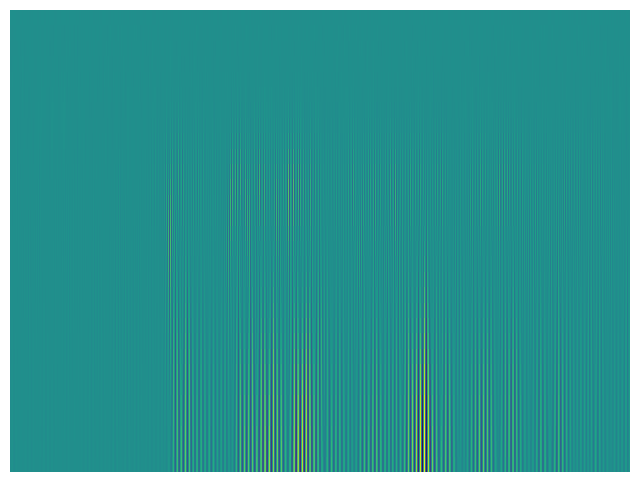

In [4]:
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import vallenae as vae
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
import pywt

TRADB = Path("C:/all/vallen/plate-dataset/sherbet-powder.tradb")
tradb=vae.io.TraDatabase(TRADB)
full_df = tradb.read()

x = full_df['data']
x.reset_index(drop=True, inplace=True)

# Generate a sample signal
#x = np.sin(np.linspace(0, 10*np.pi, 1000))
for i in tqdm(range(len(x))):

  # Compute the wavelet transform
  coeffs, freqs = pywt.cwt(x[i], np.arange(1, 31), 'morl')

  # Plot the wavelet transform
  fig = plt.figure(figsize=(8,6))
  plt.imshow(coeffs, extent=[0, 1000, 1, 31], cmap='viridis', aspect='auto',
            interpolation='nearest')
  plt.axis('off')
  plt.savefig(fr"C:\all\vallen\plate-dataset\sherbet\fig{i}")
  plt.close()

In [5]:
import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

import pathlib




In [17]:
data_dir = pathlib.Path('C:/all/vallen/plate-dataset/images')

image_count = len(list(data_dir.glob('*.png')))
print(image_count)



0


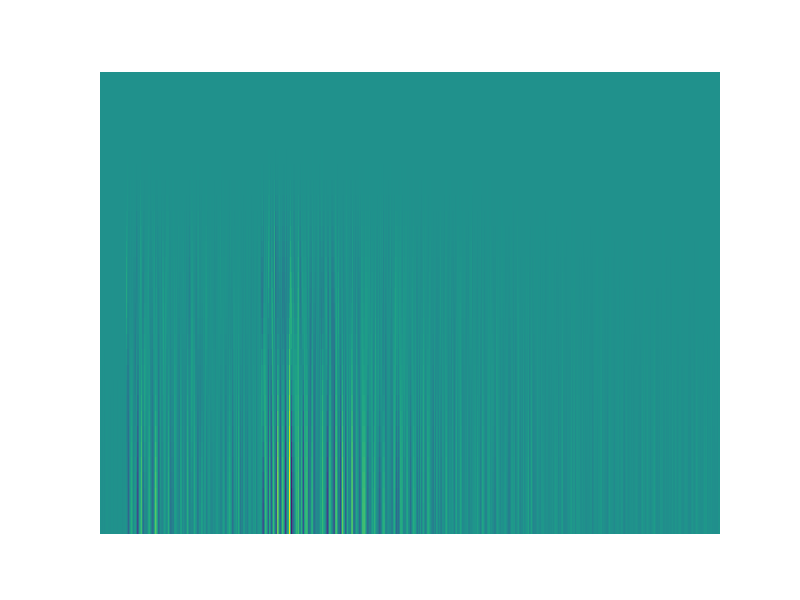

In [6]:
data_dir = pathlib.Path('C:/all/vallen/plate-dataset/images')
sand = list(data_dir.glob('sand/*'))
PIL.Image.open(str(sand[0]))

In [7]:
batch_size = 32
img_height = 600
img_width = 800

In [8]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 27857 files belonging to 4 classes.
Using 22286 files for training.


In [9]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 27857 files belonging to 4 classes.
Using 5571 files for validation.


In [10]:
class_names = train_ds.class_names
print(class_names)

['fiber', 'sand', 'sand_fd', 'sherbet']


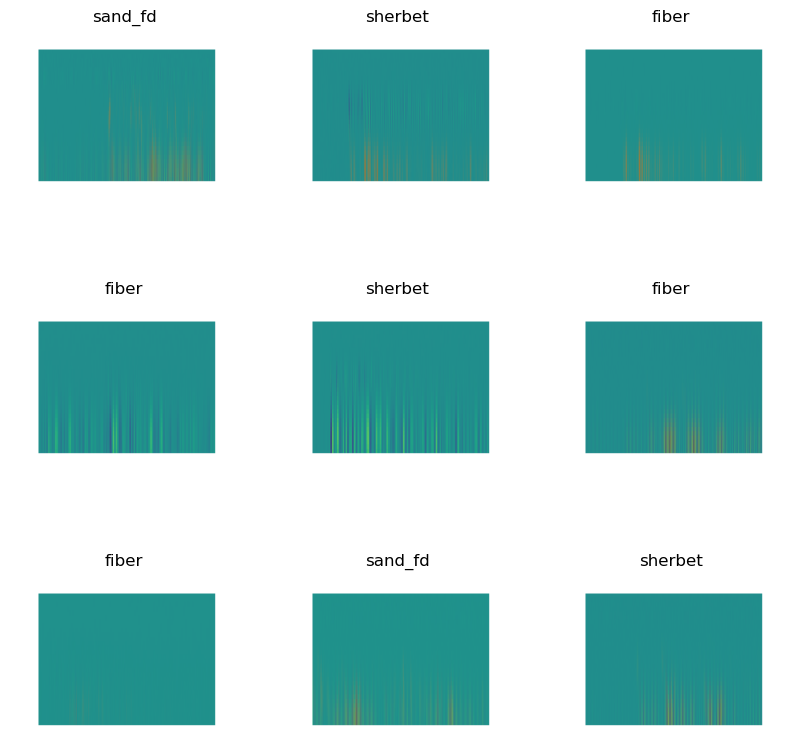

In [11]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [12]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 600, 800, 3)
(32,)


In [13]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [14]:
normalization_layer = layers.Rescaling(1./255)

In [ ]:
normalized_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))